# Load

In [1]:
%load_ext lab_black

In [2]:
# one hot encode runway
# ordinal encode airline
# TODO: Try with avg pb time, ratioH/M, ratio nominal
from traffic.core import Traffic

import pandas as pd
import numpy as np
import pickle

import os.path

from ipyleaflet import Polygon
from ipywidgets import Layout
from ipyleaflet import Map, Marker

import altair as alt

from cartes.osm import Overpass

from sklearn import svm

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import classification_report, confusion_matrix

from numpy import mean
from numpy import std
from sklearn.compose import ColumnTransformer
from sklearn.datasets import fetch_openml
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

In [5]:
from ground_analysis.build_features import gather_data

In [3]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [7]:
from ground_analysis.utils import within_Xmin
from ground_analysis.extract_flight_info import onehot_runways

ImportError: cannot import name 'onehot_runways' from 'ground_analysis.extract_flight_info' (/home/service/miniconda3/envs/traffic/lib/python3.9/site-packages/ground_analysis/extract_flight_info.py)

In [4]:
fdf_dep_path = "../data/intermediate/flight_df_DEP_v28_2019-10-01 03:58:59+00:00_2019-11-30 22:14:59+00:00.pkl"
fdf_arr_path = "../data/intermediate/flight_df_ARR_v28_2019-10-01 04:03:04+00:00_2019-11-30 21:50:22+00:00.pkl"


deps = pd.read_pickle(fdf_dep_path)
arrs = pd.read_pickle(fdf_arr_path)

AttributeError: Can't get attribute 'new_block' on <module 'pandas.core.internals.blocks' from '/home/service/miniconda3/envs/traffic/lib/python3.9/site-packages/pandas/core/internals/blocks.py'>

In [7]:
dep_arr_df = pd.read_pickle("../data/processed/dep_arr_df10_meansifis.pkl")

In [6]:
dep_arr_df_12 = pd.read_pickle(
    "../data/processed/dep_arr_df12_onehotconfig_addedsifis.pkl"
)

In [4]:
t_5_10 = Traffic.from_file("../data/samples/t_5_10_dep_arr.pkl")

# features extraction

## pushback

In [5]:
filter_dict = dict(compute_track_unwrapped=21, compute_track=21, compute_gs=21)
f = t_5_10["SWR134A_16058"].first("20T").cumulative_distance().unwrap(["compute_track"])
f_filtered = f.filter(**filter_dict).diff("compute_track_unwrapped")

In [6]:
compute_track_and_unwrapped_chart = (
    f.chart()
    .transform_fold(["compute_track", "compute_track_unwrapped"])
    .configure_axis(
        labelFont="Ubuntu",
        titleFont="Fira Sans",
        labelFontSize=15,
        titleFontSize=16,
    )
    .configure_legend(
        orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
    )
    .configure_view(stroke=None)
    .configure_title(font="Fira Sans", fontSize=18, anchor="start", dy=-10)
    .configure_header(
        labelFont="Ubuntu",
        labelFontSize=18,
        labelOrient="top",
    )
    .encode(
        alt.X("utchoursminutesseconds(timestamp)", title="time"),
        alt.Y("value:Q", title="Track angle in degrees"),
        color="key:N",
    )
)
compute_track_and_unwrapped_chart

alt.Chart(...)

In [7]:
filtered_compute_track_and_unwrapped_chart = (
    f_filtered.chart()
    .transform_fold(["compute_track", "compute_track_unwrapped"])
    .configure_axis(
        labelFont="Ubuntu",
        titleFont="Fira Sans",
        labelFontSize=15,
        titleFontSize=16,
    )
    .configure_legend(
        orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
    )
    .configure_view(stroke=None)
    .configure_title(font="Fira Sans", fontSize=18, anchor="start", dy=-10)
    .configure_header(
        labelFont="Ubuntu",
        labelFontSize=18,
        labelOrient="top",
    )
    .encode(
        alt.X("utchoursminutesseconds(timestamp)", title="time"),
        alt.Y("value:Q", title="Track angle in degrees"),
        color="key:N",
    )
)
filtered_compute_track_and_unwrapped_chart

alt.Chart(...)

In [8]:
compute_track_diff_chart = f_filtered.chart().encode(
    alt.X("utchoursminutesseconds(timestamp)", title="time"),
    alt.Y("compute_track_unwrapped_diff:Q", title="Track angle difference in degrees"),
)

df = pd.DataFrame(
    {"t": [pd.Timestamp("19:28:30", tz="utc")], "y": [150], "textof": ["➟"]}
)
text = (
    alt.Chart(df)
    .mark_text(dx=-19, dy=-5, angle=45, fontSize=35)
    .encode(x="utchoursminutesseconds(t)", y="y", text="textof")
)

(compute_track_diff_chart + text).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.LayerChart(...)

In [10]:
f.pushback("LSZH").stop

Timestamp('2019-10-05 19:28:29+0000', tz='UTC')

In [13]:
f.map_leaflet(
    zoom=13,
    highlight=dict(
        red=lambda x: x.before(pd.Timestamp("2019-10-05 19:32:00+0000", tz="UTC"))
    ),
)

Map(center=[47.45629118693077, 8.560667564318729], controls=(ZoomControl(options=['position', 'zoom_in_text', …

In [9]:
f.map_leaflet(zoom=13, highlight=dict(red=lambda x: x.pushback("LSZH")))

Map(center=[47.45629118693077, 8.560667564318729], controls=(ZoomControl(options=['position', 'zoom_in_text', …

In [ ]:
f3 = traf['EDW146Z_5711']
pbstop = f3.pushback2('LSZH').stop

f3.resample('7s').map_leaflet(zoom=13, highlight=dict(red=lambda x : x.after(pbstop).slow_taxi()))

## Twy

# Add TXOT sensitivities

## delay densities

In [11]:
datachart = dep_arr_df.query("parking_position==parking_position")[
    [
        "real_dur_minutes",
        "mvt_type",
        "total_holding_time_minutes",
        "taxi_holding_time_minutes",
        "avg_delay_30min",
    ]
]
taxiing_time_chart = (
    alt.Chart(datachart)
    .transform_density("real_dur_minutes", extent=[0, 20])
    .mark_line(color="red")
    .encode(
        alt.X("value:Q", title="Taxiing time in minutes"),
        alt.Y("density:Q"),
    )
)
taxi_chart = (
    alt.Chart(datachart)
    .transform_density("real_dur_minutes", groupby=["mvt_type"], extent=[0, 20])
    .mark_line()
    .encode(
        alt.X("value:Q", title="Taxiing time in minutes"),
        alt.Y("density:Q"),
        alt.Color("mvt_type:N"),
    )
)
delay_chart = (
    alt.Chart(datachart)
    .transform_density(
        "taxi_holding_time_minutes", groupby=["mvt_type"], extent=[0, 20]
    )
    .mark_line()
    .encode(
        alt.X("value:Q", title="OTHD"),
        alt.Y("density:Q", scale=alt.Scale(domain=[0, 0.4], clamp=True)),
        alt.Color("mvt_type:N"),
    )
)
avg_delay_chart = (
    alt.Chart(datachart.query("mvt_type=='DEP' & avg_delay_30min==avg_delay_30min"))
    .transform_density("avg_delay_30min", extent=[0, 20])
    .mark_line(color="green")
    .encode(
        alt.X("value:Q", title="Average OTHD over 30 min time windows (green) "),
        alt.Y("density:Q"),
    )
)
(taxi_chart + taxiing_time_chart | (delay_chart + avg_delay_chart)).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.HConcatChart(...)

## taxi geometry related features

In [41]:
dep_arr_df_12BIS = pd.read_pickle(
    "../data/processed/dep_arr_df12BIS_onehotconfig_addedsifis_anglesummfixed.pkl"
)

<AxesSubplot:>

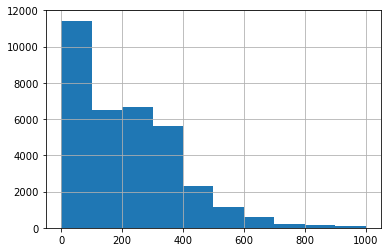

In [74]:
dep_arr_df_12BIS.angle_sum.hist(range=(0, 1000))

In [42]:
datachart = dep_arr_df_12BIS.query(
    'mvt_type=="DEP" & parking_position==parking_position & angle_sum<800'
)[["angle_sum", "taxi_dist", "taxi_holding_time_minutes"]]
alt.Chart(datachart).mark_boxplot().encode(
    alt.X(
        "angle_sum:Q",
        bin=alt.Bin(maxbins=15),
        title="Total angle turned while taxiing (in degrees)",
    ),
    alt.Y(
        "taxi_holding_time_minutes",
        title="OTHD",
    ),
    tooltip="count()",
).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

In [46]:
datachart = dep_arr_df_12BIS.query(
    'mvt_type=="DEP" & parking_position==parking_position & taxi_dist<5000'
)[["angle_sum", "taxi_dist", "taxi_holding_time_minutes"]]
alt.Chart(datachart).mark_boxplot().encode(
    alt.X(
        "taxi_dist:Q",
        bin=alt.Bin(maxbins=15),
        title="Total taxiing distance (in m)",
    ),
    alt.Y(
        "taxi_holding_time_minutes",
        title="OTHD",
    ),
    tooltip="count()",
).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

## Weather related

### Temperature

In [21]:
datachart = dep_arr_df.query(
    'mvt_type=="DEP" & parking_position==parking_position & temp==temp'
)[["temp", "taxi_dist", "taxi_holding_time_minutes"]]
alt.Chart(datachart).mark_boxplot(outliers=False).encode(
    alt.X(
        "temp:O",
        # bin=alt.Bin(maxbins=15),
        title="Temperature in °C",
    ),
    alt.Y(
        "taxi_holding_time_minutes",
        title="OTHD",
    ),
    tooltip="count()",
).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

In [19]:
datachart = dep_arr_df.query(
    'mvt_type=="DEP" & parking_position==parking_position & temp==temp'
).assign(neg_temp=lambda x: x.temp <= 0)[
    ["neg_temp", "taxi_holding_time_minutes", "avg_delay_30min"]
]

alt.Chart(datachart).mark_line().transform_density(
    "taxi_holding_time_minutes", groupby=["neg_temp"], extent=[0, 25]
).encode(
    alt.X(
        "value:Q",
        # bin=alt.Bin(maxbins=15),
        title="OTHD",
    ),
    alt.Y(
        "density:Q",
        title="Density",
    ),
    # tooltip="count()",
    color="neg_temp:N",
).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

### Pressure

In [20]:
datachart = dep_arr_df.query('parking_position==parking_position & mvt_type=="DEP"')[
    [
        "press",
        "total_holding_time_minutes",
        "taxi_holding_time_minutes",
        "avg_delay_30min",
    ]
].dropna()
wrt_total_holding_time_minutes_chart = (
    alt.Chart(datachart)
    .mark_boxplot()
    .transform_filter("datum.press>990")
    .encode(
        x=alt.X(
            "press:Q",
            bin=alt.Bin(maxbins=15),
            scale=alt.Scale(domain=[980, 1030]),
            title="Pressure (hPa)",
        ),
        y=alt.Y("taxi_holding_time_minutes:Q", title="OTHD"),
        # color="count()",
    )
)
wrt_avg_delay_in30min_chart = (
    alt.Chart(datachart)
    .mark_boxplot()
    .transform_filter("datum.press>990")
    .encode(
        x=alt.X(
            "press:Q",
            bin=alt.Bin(maxbins=15),
            scale=alt.Scale(domain=[980, 1030]),
            title="Pressure (hPa)",
        ),
        y=alt.Y("avg_delay_30min:Q", title="OTHD averages over 30 min time windows"),
        # color="count()",
    )
)
(wrt_total_holding_time_minutes_chart | wrt_avg_delay_in30min_chart).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.HConcatChart(...)

### Atmap

In [51]:
atmap_cols = [
    "atmap_visibility",
    "atmap_wind",
    "atmap_precipitation",
    "atmap_freezing",
    "atmap_danger",
]

In [54]:
datachart = dep_arr_df[atmap_cols + ["hh"]].groupby("hh").max()
atmap_chart = (
    alt.Chart(datachart.reset_index())
    .transform_fold(atmap_cols)
    .mark_bar()
    .encode(x="utcmonthdate(hh)", y="sum(value):Q", color="key:N")
)
datachart2 = dep_arr_df[
    [
        "total_holding_time_minutes",
        "hh",
        "taxi_holding_time_minutes",
        "end_pb",
        "mvt_type",
    ]
].query('end_pb==end_pb & mvt_type=="DEP"')
delay_chart = (
    alt.Chart(datachart2)
    .mark_line()
    .encode(
        x=alt.X("utcmonthdate(hh)", title="date"),
        y=alt.Y("mean(total_holding_time_minutes):Q", title="Average OTHD"),
    )
)
(atmap_chart + delay_chart).resolve_scale(y="independent").properties(
    title="Daily atmap scores and average OTHD"
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
).properties(
    width=800
)

alt.LayerChart(...)

In [14]:
datachart = dep_arr_df_12BIS.query(
    f"mvt_type=='DEP'  & on_runway_time.dt.day==5 & on_runway_time.dt.month==11"
)[["on_runway_time", "avg_delay_30min_all_trajs"]]
avgdelay_chart = (
    alt.Chart(datachart)
    .mark_line(color="orange")
    .encode(
        x=alt.X("on_runway_time", title="Time of day"),
        y=alt.Y(
            "avg_delay_30min_all_trajs:Q",
            title="Average OTHD",
        ),
    )
)

datachart = dep_arr_df_12BIS.query(
    f"mvt_type=='DEP'  & on_runway_time.dt.day==5 & on_runway_time.dt.month==11"
)[["on_runway_time", "nb_dep"]]
nbdep_chart = (
    alt.Chart(datachart)
    .mark_line()
    .encode(
        x=alt.X("on_runway_time", title="Time of day"),
        y=alt.Y("nb_dep:Q", title="Number of departures per half-hour"),
    )
)
datachart = dep_arr_df_12BIS.query(
    f"mvt_type=='DEP'  & on_runway_time.dt.day==5 & on_runway_time.dt.month==11"
)[["hh", "atmap_danger"]]
thunderstorm_chart = (
    alt.Chart(datachart)
    .mark_area(opacity=0.5, color="red")
    .encode(
        x=alt.X("hh", title="Time of day"),
        y=alt.Y("atmap_danger:Q", axis=None),
    )
)


(avgdelay_chart + nbdep_chart + thunderstorm_chart).resolve_scale(
    y="independent"
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
).properties(
    width=600, height=250
)

NameError: name 'dep_arr_df_12BIS' is not defined

# Airport operations related

## Arrivals congestion

In [55]:
datachart = dep_arr_df.query('config=="NORTH0" & mvt_type=="DEP" & end_pb==end_pb')[
    [
        "busy",
        "disrupted",
        "not_nom_arrival_ratio",
        "total_holding_time_minutes",
        "taxi_holding_time_minutes",
        "avg_delay_in60min",
        "avg_delay_in30min",
        "avg_delay_30min",
    ]
]
(
    alt.Chart(datachart)
    .mark_boxplot()
    .encode(
        x=alt.X(
            "busy:Q",
            bin=True,
            title="Ratio of non nominal arrivals",
        ),
        y=alt.Y("taxi_holding_time_minutes:Q", title="OTHD"),
        color="count():O",
    )
).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

## Number of movements

In [56]:
# 2month plot
datachart = (
    dep_arr_df[
        [
            "nb_arr",
            "nb_dep",
            "nb",
            "total_holding_time_minutes",
            "hh_num",
            "hh",
            "first_movement_start",
            "mvt_type",
            "avg_delay_30min",
        ]
    ]
    .query('mvt_type=="DEP"')
    .assign(day=lambda x: x.hh.dt.day)
    .assign(month=lambda x: x.hh.dt.month)
    .query("month==11 & 6<hh_num<=22")
    .sort_values("first_movement_start")
    .fillna(method="backfill")
)

arr_chart = (
    alt.Chart(datachart)
    .mark_line(color="orange", opacity=0.2)
    .encode(
        x=alt.X("hh_num:O", title="Half Hour during a day"),
        y=alt.Y("mean(nb_arr):Q", title="Average number of movements (dep. and arr.)"),
        detail="day:O",
    )
)

dep_chart = (
    alt.Chart(datachart)
    .mark_line(color="blue", opacity=0.2)
    .encode(
        alt.Tooltip("day"),
        x=alt.X("hh_num:O", title="Half Hour during a day"),
        y=alt.Y("mean(nb_dep):Q", title="Average number of movements (dep. and arr.)"),
        detail="day:O",
    )
)

delay_chart = (
    alt.Chart(datachart)
    .mark_line(
        color="red",
    )
    .encode(
        x=alt.X("hh_num:O", title="Half Hour during a day"),
        y=alt.Y("mean(total_holding_time_minutes):Q", title="Average OTHD"),
    )
)

all_charts = (
    alt.layer((arr_chart + dep_chart), delay_chart)
    .resolve_scale(y="independent")
    .properties(width=800, height=450)
)
all_charts.configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)
# (alt.vconcat(all_charts, depdel_chart)) | choose_date

alt.LayerChart(...)

In [57]:
datachart = dep_arr_df.query("mvt_type=='DEP' & parking_position==parking_position")[
    ["nb_dep", "total_holding_time_minutes"]
]
alt.Chart(datachart).mark_bar().encode(
    x=alt.X("nb_dep", title="Number of departures in 30 min time windows"),
    y=alt.X(
        "mean(total_holding_time_minutes)", title="Average OTHD"
    ),  # color="count()"
).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

#### turnarounds

In [30]:
def assign_turnaround_time(dep_arr_df, turnaround_df):
    # assign turnaround times
    dep_arr_df_turnaround = (
        dep_arr_df.merge(
            turnaround_df.query('turnaround<"6h"')
            .assign(hh=lambda x: x.start.dt.floor("30T"))
            .drop(
                ["callsign_in", "ALDT", "AIBT", "AOBT", "start", "firstseen_min"],
                axis=1,
            ),
            how="left",
            left_on=["callsign", "icao24", "hh"],
            right_on=["callsign_out", "icao24", "hh"],
        )
        .assign(turnaround_minutes=lambda x: x.turnaround.dt.total_seconds() / 60)
        .drop("callsign_out", axis=1)
    )

    dep_arr_df_turnaround["turnaround_minutes"] = dep_arr_df_turnaround[
        "turnaround_minutes"
    ].fillna(0)

    return dep_arr_df_turnaround


turnaround_path = "../data/intermediate/zurich_turnaround.pkl"
turnaround_df = pd.read_pickle(turnaround_path)

In [31]:
dep_df = dep_arr_df_twy.query('mvt_type=="DEP"')

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
alt.Chart(datachart).transform_density(
    "avg_outbound_delay_lastXmin", groupby=["turnaround_cat"]
).mark_line().encode(x="value:Q", y="density:Q", color="turnaround_cat:N")

In [58]:
datachart = (
    dep_arr_df_12[["taxi_holding_time_minutes", "turnaround_minutes"]]
    .dropna()
    .query("turnaround_minutes<360")
)

alt.Chart(datachart).mark_boxplot().encode(
    alt.X(
        "turnaround_minutes",
        bin=alt.Bin(maxbins=20),
        title="Turnaround time (min)",
    ),
    alt.Y("taxi_holding_time_minutes", title="OTHD (min)"),
).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

In [59]:
datachart = dep_arr_df_12[
    ["avg_delay_30min", "max_turnaround_minutes_last30T"]
].dropna()
alt.Chart(datachart).mark_boxplot().encode(
    alt.X(
        "max_turnaround_minutes_last30T",
        bin=alt.Bin(maxbins=20),
        title="Maximum turnaround time in 30 min time windows (min)",
    ),
    alt.Y("avg_delay_30min", title="OTHD averages (min)"),
).configure_axis(
    labelFont="Ubuntu",
    titleFont="Fira Sans",
    labelFontSize=15,
    titleFontSize=16,
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

### NDepDep

In [71]:
sifi_cols = ["aqli_DEP", "scfi_DEP", "aqli_ARR", "scfi_ARR"]
datachart = dep_arr_df.query('mvt_type=="DEP"')[
    ["total_holding_time_minutes"] + sifi_cols
]
alt.Chart(datachart).transform_fold(sifi_cols).transform_filter(
    "datum.value<17"
).mark_boxplot(outliers=False).encode(
    x=alt.X("value:O"),
    y=alt.Y("total_holding_time_minutes", title="OTHD"),
    facet=alt.Facet("key:N", columns=2, title=""),
).properties(
    title=""
)

alt.Chart(...)

## Mean taxiing speed

In [83]:
datachart = dep_arr_df_12.query("mvt_type=='DEP' & end_pb==end_pb & avg_speed<10")[
    ["avg_speed", "taxi_holding_time_minutes"]
]
alt.Chart(datachart).mark_boxplot().encode(
    alt.X(
        "avg_speed",
        title="Mean taxiing speed ",
        # scale=alt.Scale(domain=[0, 10], clamp=True),
        bin=alt.Bin(maxbins=20),
    ),
    alt.Y(
        "taxi_holding_time_minutes",
        title="OTHD",
    ),
    tooltip=["count()"],  # alt.Color("count()"),
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

In [84]:
datachart = dep_arr_df_12.query("mvt_type=='DEP' & end_pb==end_pb")[
    ["avg_speed_last30T", "avg_delay_30min"]
]
alt.Chart(datachart).mark_boxplot().encode(
    alt.X(
        "avg_speed_last30T",
        bin=alt.Bin(maxbins=20),
        title="Mean taxiing speed averages over 30 min time windows",
    ),
    alt.Y("avg_delay_30min", title="OTHD averages over 30 min time windows"),
    # alt.Color("count()"),
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

## TWY PCA

In [77]:
datachart = dep_arr_df.query("end_pb==end_pb & mvt_type=='DEP'")[
    ["total_holding_time_minutes", "E_occ"]
]
alt.Chart(datachart).mark_boxplot(outliers=False).encode(
    x=alt.X("E_occ:O", title="Taxiway E max occupancy"),
    y=alt.Y("total_holding_time_minutes:Q", title="OTHD"),
)

alt.Chart(...)

In [82]:
datachart = dep_arr_df.query("end_pb==end_pb & mvt_type=='DEP'")[
    ["total_holding_time_minutes", "twy_pca_0"]
]
alt.Chart(datachart).mark_boxplot(outliers=False).encode(
    x=alt.X("twy_pca_0:Q", bin=True, title="Value of the first PCA vector"),
    y=alt.Y("total_holding_time_minutes:Q", title="OTHD"),
)

alt.Chart(...)

## Rwy Config

In [85]:
datachart = dep_arr_df_12.query(
    'mvt_type=="DEP" & parking_position==parking_position & config==config & config!="NORTH1"'
)[["avg_delay_30min", "config"]]
alt.Chart(datachart).transform_density(
    "avg_delay_30min",
    extent=[0, 16],
    groupby=["config"],
    as_=["OTHD averages", "density"],
).mark_line().encode(
    alt.X("OTHD averages:Q"), alt.Y("density:Q"), strokeDash="config:N"
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

In [86]:
datachart = dep_arr_df_12.query(
    'mvt_type=="DEP" & parking_position==parking_position & (runway=="28" | runway=="16" | runway=="32")'
)[["taxi_holding_time_minutes", "runway"]]
alt.Chart(datachart).transform_density(
    "taxi_holding_time_minutes",
    extent=[0, 16],
    groupby=["runway"],
    as_=["OTHD", "density"],
).mark_line().encode(
    alt.X("OTHD:Q"), alt.Y("density:Q"), alt.Color("runway:N")
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.Chart(...)

# Prediction

In [300]:
datachart = dep_arr_df_2.query("parking_position==parking_position")[
    ["real_dur_minutes", "mvt_type", "total_holding_time_minutes", "avg_delay_30min"]
]
taxi_chart = (
    alt.Chart(datachart)
    .transform_density("real_dur_minutes", groupby=["mvt_type"], extent=[0, 20])
    .mark_line()
    .encode(
        alt.X("value:Q", title="Taxiing time in minutes"),
        alt.Y("density:Q"),
        alt.Color("mvt_type:N"),
    )
)
delay_chart = (
    alt.Chart(datachart)
    .transform_density(
        "total_holding_time_minutes", groupby=["mvt_type"], extent=[0, 20]
    )
    .mark_line()
    .encode(
        alt.X("value:Q", title="Additional Taxiing time"),
        alt.Y("density:Q"),
        alt.Color("mvt_type:N"),
    )
)
avg_delay_chart = (
    alt.Chart(datachart.query("mvt_type=='DEP' & avg_delay_30min==avg_delay_30min"))
    .transform_density("avg_delay_30min", extent=[0, 20])
    .mark_line(color="green")
    .encode(
        alt.X("value:Q", title="Average over 30 min time windows Add. TXOT (green) "),
        alt.Y("density:Q"),
    )
)
taxi_chart | (delay_chart + avg_delay_chart)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.HConcatChart(...)

## Avg delay computation and missing trajs

In [80]:
df1 = dep_arr_df_12.query(
    f"mvt_type=='DEP' & runway=='16' & parking_position!=parking_position"
).taxi_dist.describe()  # 2190 when not urequestin a pp, 789 when requesting

df2 = dep_arr_df_12.query(
    f"mvt_type=='DEP' & runway=='28' & parking_position!=parking_position"
).taxi_dist.describe()  # 2190 when not urequestin a pp, 789 when requesting

df3 = dep_arr_df_12.query(
    f"mvt_type=='DEP' & runway=='32' & parking_position!=parking_position"
).taxi_dist.describe()  # 2190 when not urequestin a pp, 789 when requesting

df4 = pd.concat([df1, df2, df3], axis=1)

pd.set_option("precision", 2)

print(df4.to_latex())

\begin{tabular}{lrrr}
\toprule
{} &  taxi\_dist &  taxi\_dist &  taxi\_dist \\
\midrule
count &     789.00 &    6204.00 &    1827.00 \\
mean  &    2505.39 &    1111.17 &     994.66 \\
std   &     851.13 &     839.61 &     685.73 \\
min   &       7.07 &       0.00 &       0.00 \\
25\%   &    2079.98 &     246.62 &     416.88 \\
50\%   &    2556.11 &    1219.78 &     803.84 \\
75\%   &    3141.73 &    1745.42 &    1608.31 \\
max   &    5400.52 &   15652.80 &    6303.50 \\
\bottomrule
\end{tabular}



## different avg delays during one day + compare with individual delays

In [22]:
dep_arr_df = pd.read_pickle(
    "../data/processed/dep_arr_df12BIS_onehotconfig_addedsifis_anglesummfixed.pkl"
)
dep_arr_df14 = pd.read_pickle(
    "../data/processed/dep_arr_df14_nextavgdelaybetteraffected.pkl"
)

In [88]:
nday = 6
nmonth = 10

datachart = dep_arr_df.query(
    f"parking_position==parking_position & mvt_type=='DEP' & on_runway_time.dt.day=={nday} & on_runway_time.dt.month=={nmonth}"
)[["on_runway_time", "taxi_holding_time_minutes", "avg_delay_30min"]].assign(
    linelabel="Additional TXOT",
    barlabel="Additional TXOT averaged by 30min rolling window",
)
taxidelay_chart = (
    alt.Chart(datachart)
    .mark_circle(opacity=0.9, size=50, color="yellow")
    .encode(
        alt.X("on_runway_time", title="Time of day"),
        alt.Y("taxi_holding_time_minutes", title="OTHD"),
        # color="barlabel",
    )
)
avgdelay_chart = (
    alt.Chart(datachart)
    .mark_line(color="orange", opacity=0.75)
    .encode(
        alt.X("on_runway_time", title="Time of day"),
        alt.Y("avg_delay_30min", title="Average OTHD"),
        # opacity="linelabel",
    )
)

avgdelay_addtxot_sample_day_chart = taxidelay_chart + avgdelay_chart


datachart = dep_arr_df.query(
    f"mvt_type=='DEP'  & on_runway_time.dt.day=={nday} & on_runway_time.dt.month=={nmonth}"
)[["on_runway_time", "taxi_holding_time_minutes", "avg_delay_30min_all_trajs"]]
alltrajsdelay_chart = (
    alt.Chart(datachart)
    .mark_line(color="green", opacity=0.75)
    .encode(x="on_runway_time", y="avg_delay_30min_all_trajs")
)

datachart = dep_arr_df.query(
    f"mvt_type=='DEP' & on_runway_time.dt.day=={nday} & on_runway_time.dt.month=={nmonth}"
)[["on_runway_time", "taxi_holding_time_minutes", "avg_delay_30min_all_trajs"]]
taxidelayalltrajs_chart = (
    alt.Chart(datachart)
    .mark_circle(color="green", opacity=0.4)
    .encode(x="on_runway_time", y="taxi_holding_time_minutes")
)

datachart = dep_arr_df14.query(
    f"parking_position==parking_position & mvt_type=='DEP' & on_runway_time.dt.day=={nday} & on_runway_time.dt.month=={nmonth}"
)[["on_runway_time", "avg_delay_30min"]]
longenoughtaxi_chart = (
    alt.Chart(datachart)
    .mark_line(color="red", opacity=0.75)
    .encode(alt.X("on_runway_time:T"), alt.Y("avg_delay_30min"))
)

datachart = dep_arr_df14.query(
    f"mvt_type=='DEP' & on_runway_time.dt.day=={nday} & on_runway_time.dt.month=={nmonth} & parking_position!=parking_position & ((taxi_dist>1100 & runway=='32') |  (taxi_dist>1100 & runway=='28') | (taxi_dist>2200 & runway=='16'))"
)[["on_runway_time", "taxi_holding_time_minutes"]]
taxidelaylongenoughtrajs_chart = (
    alt.Chart(datachart)
    .mark_circle(color="red", opacity=0.33, size=70)
    .encode(x="on_runway_time", y="taxi_holding_time_minutes")
)

(
    (
        avgdelay_addtxot_sample_day_chart
        + alltrajsdelay_chart
        + taxidelayalltrajs_chart
        + longenoughtaxi_chart
        + taxidelaylongenoughtrajs_chart
    )
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
).properties(
    width=800
)

alt.LayerChart(...)

## Examples of min dist taxi trajs

In [85]:
t_sample_longenoughlimit = Traffic(pd.DataFrame([]))
fids = (
    dep_arr_df_12.query(
        f"mvt_type=='DEP' & runway=='16' & parking_position!=parking_position & 2200<taxi_dist<2250"
    )
    .sample(8)
    .flight_id
)
t = Traffic.from_flights([traf[fid].onground() for fid in fids])
t_sample_longenoughlimit = t_sample_longenoughlimit + t

t_sample_longenoughlimit.map_leaflet(zoom=13)

Map(center=[47.47132417729691, 8.541032377442459], controls=(ZoomControl(options=['position', 'zoom_in_text', …

In [88]:
t_sample_longenoughlimit = Traffic(pd.DataFrame([]))
fids = (
    dep_arr_df_12.query(
        f"mvt_type=='DEP' & runway=='28' & parking_position!=parking_position & 1100<taxi_dist<1150"
    )
    .sample(8)
    .flight_id
)
t = Traffic.from_flights([traf[fid].onground() for fid in fids])
t_sample_longenoughlimit = t_sample_longenoughlimit + t

t_sample_longenoughlimit.map_leaflet(zoom=13)

Map(center=[47.45601713551572, 8.565994217744466], controls=(ZoomControl(options=['position', 'zoom_in_text', …

In [108]:
t_sample_longenoughlimit = Traffic(pd.DataFrame([]))
fids = (
    dep_arr_df_12.query(
        f"mvt_type=='DEP' & runway=='32' & parking_position!=parking_position & 1100<taxi_dist<1150"
    )
    .sample(8)
    .flight_id
)
t = Traffic.from_flights([traf[fid].onground() for fid in fids])
t_sample_longenoughlimit = t_sample_longenoughlimit + t

t_sample_longenoughlimit.map_leaflet(zoom=13)

Map(center=[47.45882309126693, 8.561865854649115], controls=(ZoomControl(options=['position', 'zoom_in_text', …

## densities of avg delay distributions with different filterings

In [28]:
dep_arr_df_14 = pd.read_pickle(
    "../data/processed/dep_arr_df14_nextavgdelaybetteraffected.pkl"
)
dep_arr_df14.shape

(35517, 121)

In [29]:
dep_arr_df_12 = pd.read_pickle(
    "../data/processed/dep_arr_df12_onehotconfig_addedsifis.pkl"
)
dep_arr_df_12.shape

(35530, 121)

In [91]:
avg_cols = [
    "avg_delay_30min",
    "avg_delay_30min_all_trajs",
]
datachart = dep_arr_df_12.query("mvt_type=='DEP'")[avg_cols]

avg_delay_30min_chart = (
    alt.Chart(datachart.dropna())
    .transform_density("avg_delay_30min", extent=[0, 15])
    .mark_line(color="red")
    .encode(alt.X("value:Q"), alt.Y("density:Q"))
)
avg_delay_30min_all_trajs_chart = (
    alt.Chart(datachart.dropna())
    .transform_density("avg_delay_30min_all_trajs", extent=[0, 15])
    .mark_line(color="green")
    .encode(alt.X("value:Q"), alt.Y("density:Q"))
)

datachart = dep_arr_df_14.query("mvt_type=='DEP'")[avg_cols]

new_avg_delay_30min_chart = (
    alt.Chart(datachart.dropna())
    .transform_density("avg_delay_30min", extent=[0, 15])
    .mark_line(color="blue")
    .encode(alt.X("value:Q", title="OTHD averages (min)"), alt.Y("density:Q"))
)
(
    avg_delay_30min_chart + avg_delay_30min_all_trajs_chart + new_avg_delay_30min_chart
).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.LayerChart(...)

In [90]:
df1 = (
    dep_arr_df_12.query(
        "mvt_type=='DEP' & parking_position == parking_position & 6<=hh_num<=22"
    )
    .sort_values("first_movement_start")
    .set_index("first_movement_start")["flight_id"]
    .rolling("30T", closed="left")
    .count()
    .describe()
)

df2 = (
    dep_arr_df_12.query("mvt_type=='DEP' & 6<=hh_num<=22")
    .sort_values("first_movement_start")
    .set_index("first_movement_start")["flight_id"]
    .rolling("30T", closed="left")
    .count()
    .describe()
)

df3 = (
    dep_arr_df_12.query(
        "mvt_type=='DEP' & 6<=hh_num<=22 & (parking_position == parking_position | (taxi_dist>1100 & runway=='32') |  (taxi_dist>1100 & runway=='28') | (taxi_dist>2200 & runway=='16'))"
    )
    .sort_values("first_movement_start")
    .set_index("first_movement_start")["flight_id"]
    .rolling("30T", closed="left")
    .count()
    .describe()
)

res = pd.concat([df1, df2, df3], axis=1)
pd.set_option("precision", 2)
print(res.to_latex())

\begin{tabular}{lrrr}
\toprule
{} &  flight\_id &  flight\_id &  flight\_id \\
\midrule
count &    6209.00 &   14955.00 &   10828.00 \\
mean  &       4.21 &       9.14 &       7.00 \\
std   &       2.51 &       4.27 &       3.57 \\
min   &       1.00 &       1.00 &       1.00 \\
25\%   &       2.00 &       6.00 &       4.00 \\
50\%   &       4.00 &       9.00 &       7.00 \\
75\%   &       6.00 &      12.00 &      10.00 \\
max   &      18.00 &      22.00 &      19.00 \\
\bottomrule
\end{tabular}



# Appendix

## Features table

In [174]:
dict_feature_sets = {}
dict_feature_sets["target_cols"] = [
    "taxi_holding_time_minutes",
    "total_holding_time_minutes",
    "real_dur_minutes",
    "avg_delay_30min",
    "avg_delay_30min_all_trajs",
    "avg_delay_in30min",
    "avg_delay_in60min",
    "avg_delay_in90min",
    "avg_delay_in30min_cat",
    "avg_delay_in60min_cat",
    "avg_delay_in90min_cat",
    "taxi_holding_time_minutes_cat",
]
dict_feature_sets["taxi_geom_cols"] = ["taxi_dist", "angle_sum"]
dict_feature_sets["leaving_gate_cols"] = ["turnaround_minutes", "sifi_DEP", "sifi_ARR"]
dict_feature_sets["additional_cols"] = [
    "max_turnaround_minutes_last30T",
    "hh_num",
    "avg_delay_30min",
]
dict_feature_sets["one_hot_flight_rel"] = [
    "H",
    "L",
    "L/M",
    "M",
    "runway_10",
    "runway_14",
    "runway_16",
    "runway_28",
    "runway_32",
    "runway_34",
]
dict_feature_sets["wtc_counts_ratios"] = [
    "H_count",
    "L_count",
    "L/M_count",
    "M_count",
    "H_count_ratio",
    "L_count_ratio",
    "L/M_count_ratio",
    "M_count_ratio",
]
dict_feature_sets["twy_occ_cols"] = [
    "H_occ",
    "K_occ",
    "B_occ",
    "F_occ",
    "L_occ",
    "J_occ",
    "E_occ",
    "D_occ",
    "C_occ",
    "N_occ",
    "A_occ",
    "M_occ",
    "Y_occ",
    "R_occ",
    "G_occ",
    "Z_occ",
    "P_occ",
    "twy_pca_0",
    "twy_pca_1",
    "twy_pca_2",
]
dict_feature_sets["aqlis_scfis_cols"] = [
    "aqli_DEP",
    "scfi_DEP",
    "aqli_ARR",
    "scfi_ARR",
    "mean_sifi_DEP_last30T",
    "mean_sifi_ARR_last30T",
    "mean_aqli_DEP_last30T",
    "mean_scfi_DEP_last30T",
    "mean_aqli_ARR_last30T",
    "mean_scfi_ARR_last30T",
]
dict_feature_sets["weather_cols"] = [
    "press",
    "temp",
    "atmap_visibility",
    "atmap_wind",
    "atmap_precipitation",
    "atmap_freezing",
    "atmap_danger",
    "atmap_score",
]
dict_feature_sets["apt_congest_cols"] = [
    "nominal",
    "busy",
    "disrupted",
    "not_nom_arrival_ratio",
    "nb_arr",
    "nb_dep",
    "nb",
    "avg_speed_last30T",
    "avg_speed_last15T",
    "config_EAST",
    "config_NORTH0",
    "config_NORTH1",
    "config_SOUTH",
]

dict_feature_sets["taxi_profile_cols"] = ["avg_speed"]

In [175]:
main_feature_sets = dict(
    wang_all=dict_feature_sets["taxi_geom_cols"]
    + dict_feature_sets["leaving_gate_cols"]
    + dict_feature_sets["additional_cols"]
    + dict_feature_sets["one_hot_flight_rel"]
    + dict_feature_sets["wtc_counts_ratios"]
    + dict_feature_sets["twy_occ_cols"]
    + dict_feature_sets["aqlis_scfis_cols"]
    + dict_feature_sets["weather_cols"]
    + dict_feature_sets["apt_congest_cols"]
    + ["DEP"],
    wang_noaqlis=dict_feature_sets["taxi_geom_cols"]
    + dict_feature_sets["leaving_gate_cols"]
    + dict_feature_sets["additional_cols"]
    + dict_feature_sets["one_hot_flight_rel"]
    + dict_feature_sets["wtc_counts_ratios"]
    + dict_feature_sets["twy_occ_cols"]
    + dict_feature_sets["weather_cols"]
    + dict_feature_sets["apt_congest_cols"]
    + ["DEP"],
    wang_few=["taxi_dist", "angle_sum", "DEP", "temp", "sifi_DEP"],
    # For prediction of average delay : no flight specific feature
    avg_delay_pred=  # dict_feature_sets["taxi_geom_cols"]
    # + dict_feature_sets["leaving_gate_cols"]
    dict_feature_sets["additional_cols"]  # max turnaround 30 min is ok
    # + dict_feature_sets["one_hot_flight_rel"]
    + dict_feature_sets["wtc_counts_ratios"]
    + dict_feature_sets["twy_occ_cols"]
    + dict_feature_sets["weather_cols"]
    + dict_feature_sets["apt_congest_cols"],
    # + ["DEP"], we know it is a departure
)

In [222]:
dep_arr_df_14["DEP"] = np.where(dep_arr_df_14["mvt_type"] == "DEP", 1, 0)

In [224]:
pd.set_option("precision", 1)

In [242]:
small_desc_df = dep_arr_df_14[main_feature_sets["wang_all"]].describe().loc[["count"]]

In [243]:
import pandas as pd

dictionary_test = main_feature_sets
values = main_feature_sets["wang_all"]
data = {}
for key in dictionary_test.keys():
    data[key] = [True if value in dictionary_test[key] else False for value in values]

feature_df = pd.DataFrame(data, index=values)

In [244]:
small_desc_df.transpose()

,count
taxi_dist,35517.0
angle_sum,35235.0
turnaround_minutes,16445.0
sifi_DEP,6050.0
sifi_ARR,6050.0
...,...
config_EAST,35517.0
config_NORTH0,35517.0
config_NORTH1,35517.0
config_SOUTH,35517.0


In [245]:
feature_df = feature_df.merge(
    small_desc_df.transpose(), how="left", left_index=True, right_index=True
)

In [246]:
import pandas as pd

dictionary_test = dict_feature_sets
values = main_feature_sets["wang_all"]
data = {}
for key in dictionary_test.keys():
    data[key] = [True if value in dictionary_test[key] else False for value in values]

feature_cats_df = pd.DataFrame(data, index=values)
feature_cats_df

,target_cols,taxi_geom_cols,leaving_gate_cols,additional_cols,one_hot_flight_rel,wtc_counts_ratios,twy_occ_cols,aqlis_scfis_cols,weather_cols,apt_congest_cols,taxi_profile_cols
taxi_dist,False,True,False,False,False,False,False,False,False,False,False
angle_sum,False,True,False,False,False,False,False,False,False,False,False
turnaround_minutes,False,False,True,False,False,False,False,False,False,False,False
sifi_DEP,False,False,True,False,False,False,False,False,False,False,False
sifi_ARR,False,False,True,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...
config_EAST,False,False,False,False,False,False,False,False,False,True,False
config_NORTH0,False,False,False,False,False,False,False,False,False,True,False
config_NORTH1,False,False,False,False,False,False,False,False,False,True,False
config_SOUTH,False,False,False,False,False,False,False,False,False,True,False


In [247]:
def get_colname(row):
    for c in feature_cats_df.columns:
        if row[c]:
            return c


s_feature_cat = feature_cats_df.apply(get_colname, axis=1)

In [248]:
s_feature_cat

taxi_dist                taxi_geom_cols
angle_sum                taxi_geom_cols
turnaround_minutes    leaving_gate_cols
sifi_DEP              leaving_gate_cols
sifi_ARR              leaving_gate_cols
                            ...        
config_EAST            apt_congest_cols
config_NORTH0          apt_congest_cols
config_NORTH1          apt_congest_cols
config_SOUTH           apt_congest_cols
DEP                                None
Length: 78, dtype: object

In [249]:
l_index = []
for u, v in s_feature_cat.iteritems():
    l_index.append((v, u))

In [250]:
index = pd.MultiIndex.from_tuples(l_index, names=["Category", "Name"])

In [251]:
feature_df.index = index

In [252]:
print(
    (feature_df.drop(["wang_few"], axis=1).replace({False: " ", True: "X"})).to_latex(
        multirow=True, longtable=True
    )
)

\begin{longtable}{lllllr}
\toprule
    &     & wang\_all & wang\_noaqlis & avg\_delay\_pred &    count \\
Category & Name &          &              &                &          \\
\midrule
\endfirsthead

\toprule
    &     & wang\_all & wang\_noaqlis & avg\_delay\_pred &    count \\
Category & Name &          &              &                &          \\
\midrule
\endhead
\midrule
\multicolumn{6}{r}{{Continued on next page}} \\
\midrule
\endfoot

\bottomrule
\endlastfoot
\multirow{2}{*}{taxi\_geom\_cols} & taxi\_dist &        X &            X &                &  35517.0 \\
    & angle\_sum &        X &            X &                &  35235.0 \\
\cline{1-6}
\multirow{3}{*}{leaving\_gate\_cols} & turnaround\_minutes &        X &            X &                &  16445.0 \\
    & sifi\_DEP &        X &            X &                &   6050.0 \\
    & sifi\_ARR &        X &            X &                &   6050.0 \\
\cline{1-6}
\multirow{2}{*}{additional\_cols} & max\_turnaround\_minutes\

## Corr mat

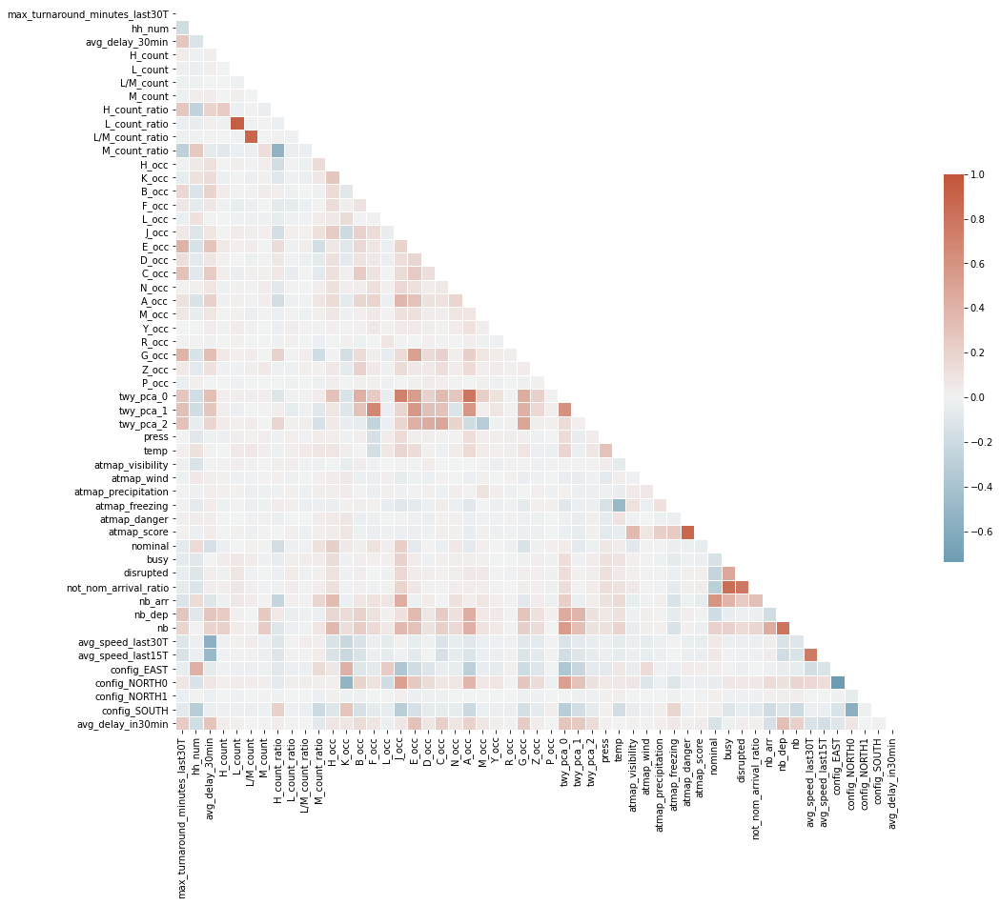

In [169]:
import seaborn as sns

import matplotlib.pyplot as plt

corr = dep_arr_df[
    main_feature_sets["avg_delay_pred"] + ["avg_delay_in30min"]
].corr()  # wang_all
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(17, 15))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(
    corr,
    mask=mask,
    cmap=cmap,
    vmax=1,
    center=0,
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
)
# sns.heatmap(correlation_mat, annot=False, cmap="twilight")

plt.show()

# others

In [78]:
datachart = dep_arr_df.query("avg_speed<40")[
    ["avg_speed", "total_holding_time_minutes"]
]
alt.Chart(datachart).mark_bar().encode(
    x=alt.X("avg_speed:Q", bin=True),
    y="mean(total_holding_time_minutes):Q",
    color="count()",
)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

## Delay examples for one day

In [77]:
datachart = dep_arr_df_12BIS.query(
    "parking_position==parking_position & mvt_type=='DEP' & first_movement_start.dt.day==25 & first_movement_start.dt.month==10"
)[["first_movement_start", "taxi_holding_time_minutes", "avg_delay_30min"]]
taxidelay_chart = (
    alt.Chart(datachart)
    .mark_bar(opacity=0.4)
    .encode(alt.X("first_movement_start", title='Time of day'), alt.Y("taxi_holding_time_minutes", title="Additional TXOT"))
)
avgdelay_chart = (
    alt.Chart(datachart)
    .mark_line(color="orange", opacity=1)
    .encode(alt.X("first_movement_start", title='Time of day'), alt.Y("avg_delay_30min", title="Average additional TXOT"))
)

(taxidelay_chart + avgdelay_chart).configure_legend(
    orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
).configure_view(
    stroke=None
).configure_title(
    font="Fira Sans", fontSize=18, anchor="start", dy=-10
).configure_header(
    labelFont="Ubuntu",
    labelFontSize=18,
    labelOrient="top",
)

alt.LayerChart(...)